# 安装Detectron2和依赖项

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-bci55lr5
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-bci55lr5
  Resolved https://github.com/facebookresearch/detectron2.git to commit b1c43ffbc995426a9a6b5c667730091a384e0fa4
  Preparing metadata (setup.py) ... done


In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.5 ; cuda:  cu121
detectron2: 0.6


In [ ]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

# 导入示例图片

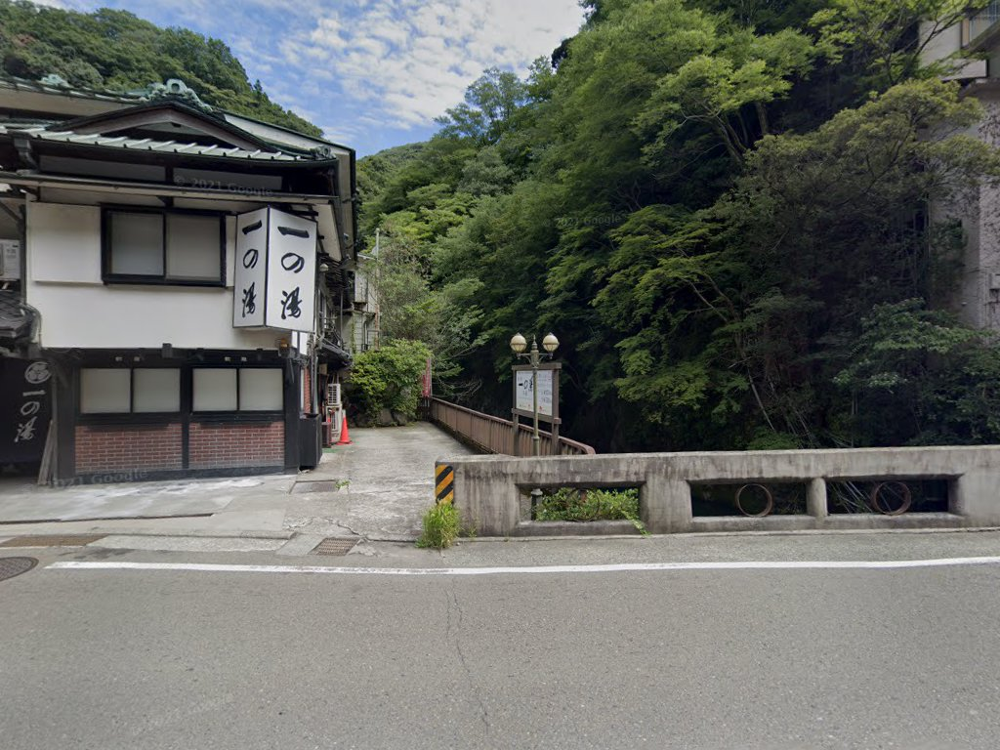

In [ ]:
image = cv2.imread("/content/gdrive/MyDrive/building_ins_seg/train/100598_1.jpg")
cv2_imshow(image)

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(image)

NameError: name 'image' is not defined

In [ ]:
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([74], device='cuda:0')
Boxes(tensor([[238.0371, 213.5182, 323.3289, 340.9571]], device='cuda:0'))


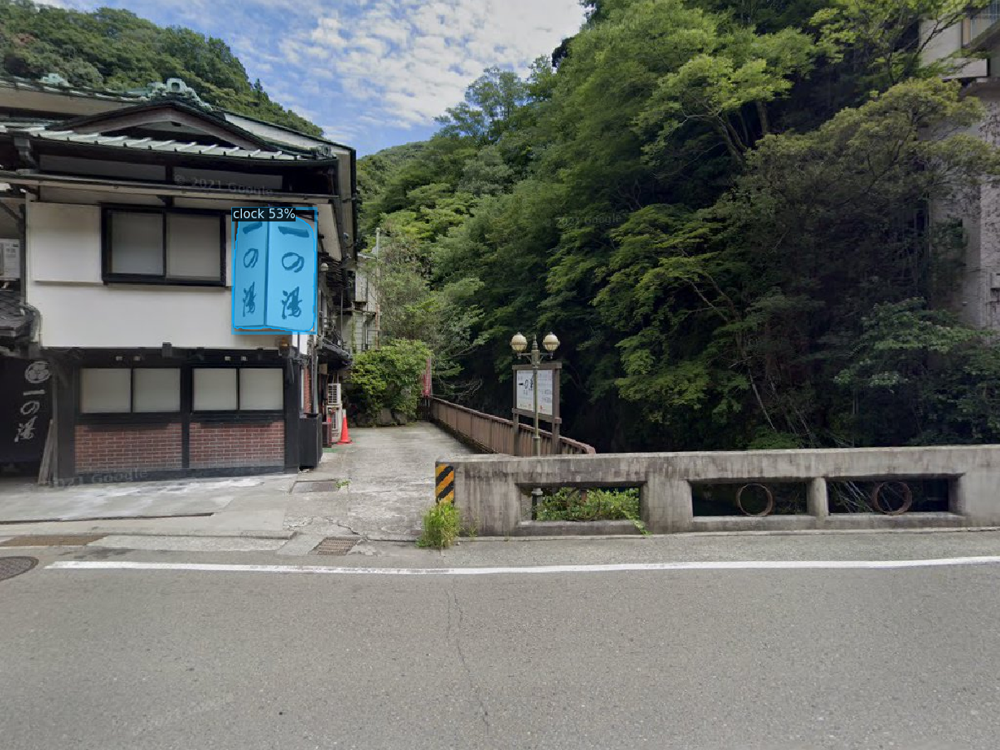

In [ ]:
visualizer = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
DATA_SET_NAME = "building_ins_seg"

# TRAIN SET
TRAIN_DATA_SET_NAME = "train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = "/content/gdrive/MyDrive/building_ins_seg/train"
TRAIN_DATA_SET_ANN_FILE_PATH = "/content/gdrive/MyDrive/building_ins_seg/train//building_ins_seg_train.json"

register_coco_instances(
    name=TRAIN_DATA_SET_NAME,
    metadata={},
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH,
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)

TEST_DATA_SET_NAME = "test"
TEST_DATA_SET_IMAGES_DIR_PATH = "/content/gdrive/MyDrive/building_ins_seg/test"
TEST_DATA_SET_ANN_FILE_PATH = "/content/gdrive/MyDrive/building_ins_seg/test/building_ins_seg_test.json"

register_coco_instances(
    name=TEST_DATA_SET_NAME,
    metadata={},
    json_file=TEST_DATA_SET_ANN_FILE_PATH,
    image_root=TEST_DATA_SET_IMAGES_DIR_PATH
)


In [ ]:
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

[]

train


Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



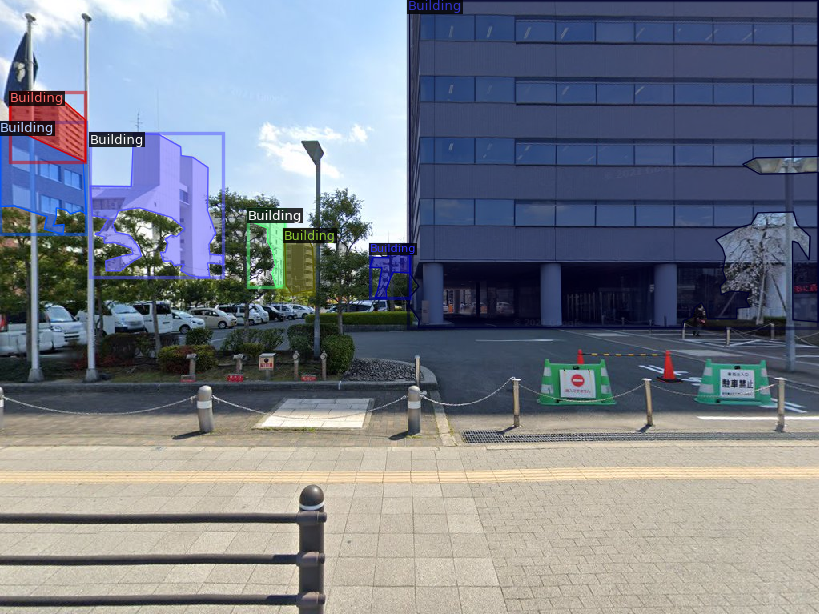

In [ ]:
metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
print(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

dataset_entry = dataset_train[0]
image = cv2.imread(dataset_entry["file_name"])

visualizer = Visualizer(
    image[:, :, ::-1],
    metadata=metadata,
    scale=0.8,
    instance_mode=ColorMode.IMAGE_BW
)

out = visualizer.draw_dataset_dict(dataset_entry)
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# HYPERPARAMETERS
ARCHITECTURE = "mask_rcnn_R_101_FPN_3x"
CONFIG_FILE_PATH = f"COCO-InstanceSegmentation/{ARCHITECTURE}.yaml"
#CONFIG_FILE_PATH = "Cityscapes/mask_rcnn_R_50_FPN.yaml"
MAX_ITER = 3000
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 1

# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME,
    ARCHITECTURE,
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)

os.makedirs(OUTPUT_DIR_PATH, exist_ok=True)

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH)
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.INPUT.MASK_FORMAT='bitmask'
cfg.SOLVER.BASE_LR = BASE_LR
cfg.SOLVER.MAX_ITER = MAX_ITER
cfg.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg.OUTPUT_DIR = OUTPUT_DIR_PATH

In [ ]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/29 10:07:10 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:12, 19.8MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[12/29 10:07:24 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[12/29 10:07:41 d2.utils.events]:  eta: 0:31:45  iter: 19  total_loss: 1.787  loss_cls: 0.5293  loss_box_reg: 0.1218  loss_mask: 0.6907  loss_rpn_cls: 0.3606  loss_rpn_loc: 0.03787    time: 0.6894  last_time: 0.6334  data_time: 0.5379  last_data_time: 0.5118   lr: 1.9981e-05  max_mem: 2836M
[12/29 10:07:59 d2.utils.events]:  eta: 0:32:39  iter: 39  total_loss: 1.771  loss_cls: 0.4674  loss_box_reg: 0.2589  loss_mask: 0.6601  loss_rpn_cls: 0.2552  loss_rpn_loc: 0.03849    time: 0.6835  last_time: 0.6668  data_time: 0.5565  last_data_time: 0.5487   lr: 3.9961e-05  max_mem: 2836M
[12/29 10:08:13 d2.utils.events]:  eta: 0:32:12  iter: 59  total_loss: 1.882  loss_cls: 0.4353  loss_box_reg: 0.6204  loss_mask: 0.6304  loss_rpn_cls: 0.1624  loss_rpn_loc: 0.02993    time: 0.6891  last_time: 0.6215  data_time: 0.5837  last_data_time: 0.5135   lr: 5.9941e-05  max_mem: 2852M
[12/29 10:08:26 d2.utils.events]:  eta: 0:31:54  iter: 79  total_loss: 2.003  loss_cls: 0.4165  loss_box_reg: 0.8681  loss_m

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 9768), started 0:01:03 ago. (Use '!kill 9768' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
#cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.WEIGHTS = "/content/building_ins_seg/mask_rcnn_R_101_FPN_3x/2024-12-29-10-07-09/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# 假设您已经设置好了模型和配置
# cfg = ...

# 创建评估器
evaluator = COCOEvaluator(TEST_DATA_SET_NAME, cfg, False, output_dir="/content")
val_loader = build_detection_test_loader(cfg, TEST_DATA_SET_NAME)

# 运行评估
results = inference_on_dataset(predictor.model, val_loader, evaluator)

print(results)


WARNING [12/26 11:24:52 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [12/26 11:24:52 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/26 11:24:52 d2.data.datasets.coco]: Loaded 561 images in COCO format from /content/gdrive/MyDrive/building_ins_seg/test/building_ins_seg_test.json
[12/26 11:24:52 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(1024, 1024), max_size=2048, sample_style='choice')]
[12/26 11:24:52 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[12/26 11:24:52 d2.data.common]: Serializing 561 elements to byte tensors and concatenating them all ...
[12/26 11:24:52 d2.data.common]: Serialized dataset takes 1.43 MiB
[12/26 11:24:52 d2.evaluation.evaluator]: Start inference on 561 batch

In [ ]:
!pip install distinctipy


In [ ]:
import cv2
import numpy as np
import torch
from detectron2.utils.visualizer import ColorMode
import distinctipy  # 导入 distinctipy 库

# 读取图像
img = cv2.imread("/content/731_1.jpg")
outputs = predictor(img)

# 获取实例掩码
instances = outputs["instances"].to("cpu")
masks = instances.pred_masks.numpy()  # 转换掩码为 numpy 数组

# 创建一个与原始图像大小相同的空白图，用于存储纯色掩码
segmentation_mask = np.zeros_like(img, dtype=np.uint8)

# 生成与实例数量相同的高对比度颜色
num_instances = masks.shape[0]
colors = distinctipy.get_colors(num_instances)  # 获取颜色列表

# 将颜色从 [0, 1] 范围转换到 [0, 255]，并转换为整数
colors = [(int(r * 255), int(g * 255), int(b * 255)) for r, g, b in colors]

# 定义背景颜色为棕色（RGB）
background_color = (165, 42, 42)

# 用棕色填充整个背景
segmentation_mask[:, :] = background_color

# 为每个掩码区域填充高对比度的纯色
for i in range(num_instances):
    mask = masks[i]
    segmentation_mask[mask] = colors[i]  # 用纯色填充掩码区域

# 保存纯色掩码图
output_path = "colored_segmentation_mask.png"
cv2.imwrite(output_path, segmentation_mask)

print(f"纯色掩码图已保存到: {output_path}")


纯色掩码图已保存到: colored_segmentation_mask.png


WARNING [12/29 10:56:57 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/29 10:56:57 d2.data.datasets.coco]: Loaded 561 images in COCO format from /content/gdrive/MyDrive/building_ins_seg/test/building_ins_seg_test.json


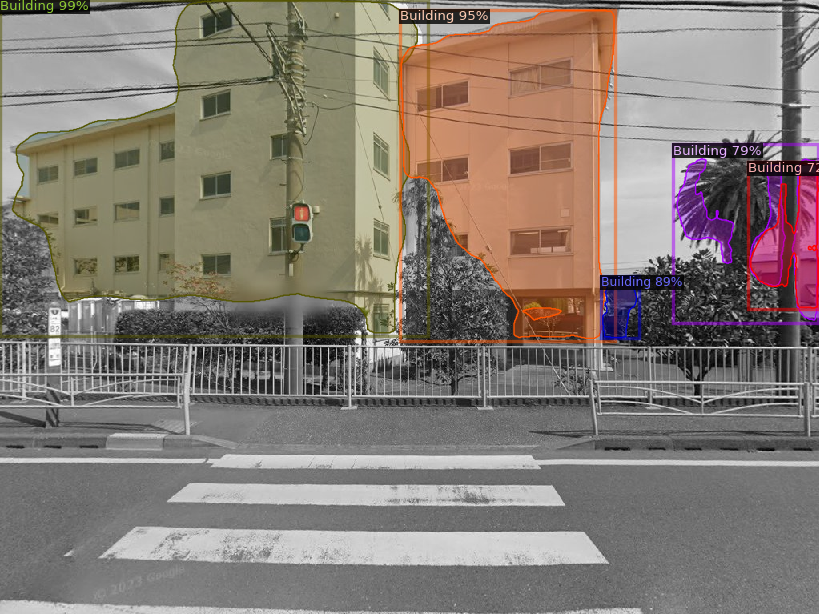

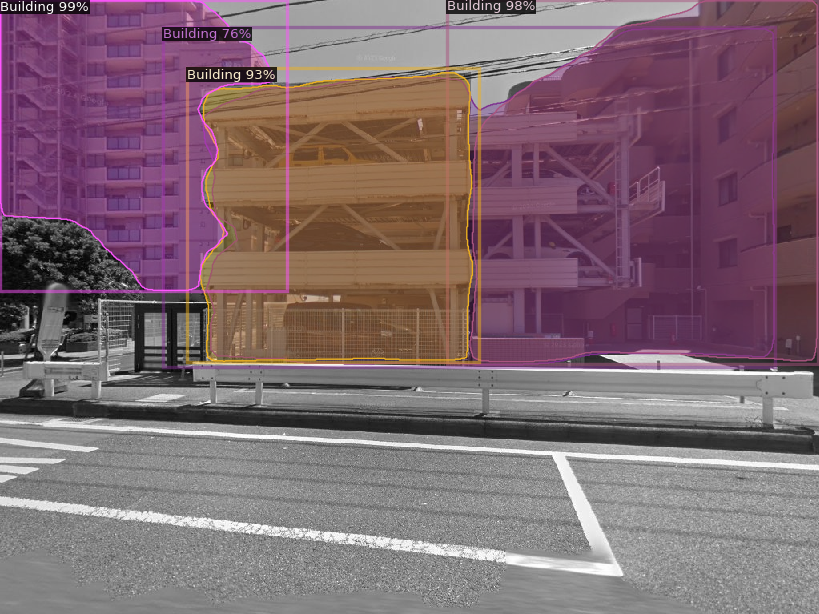

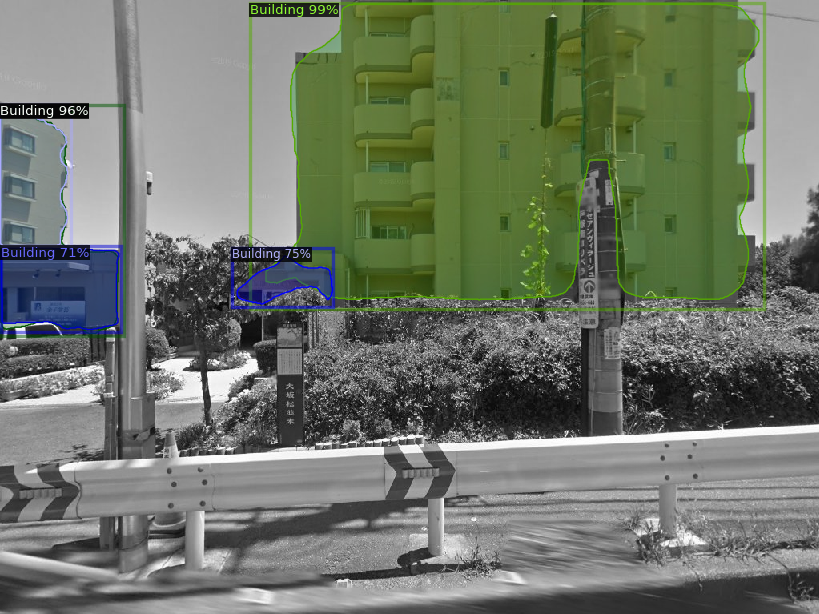

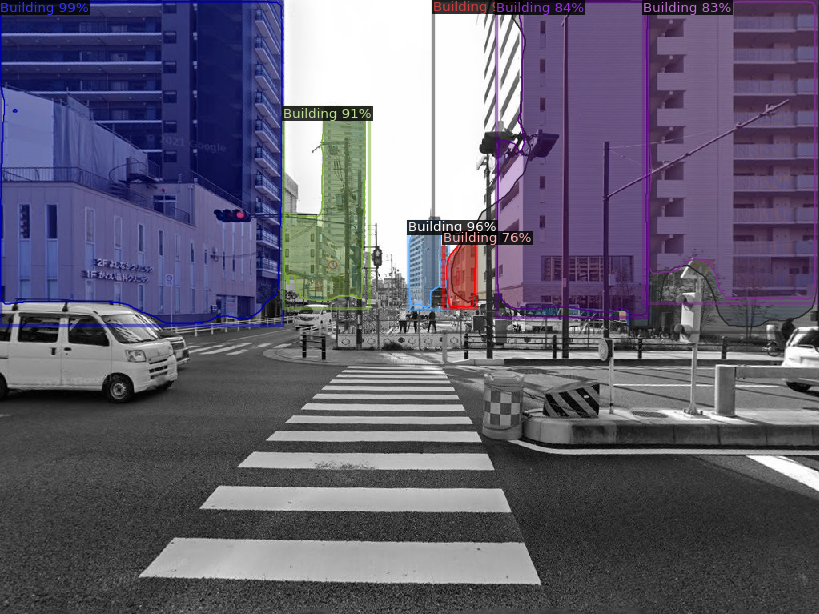

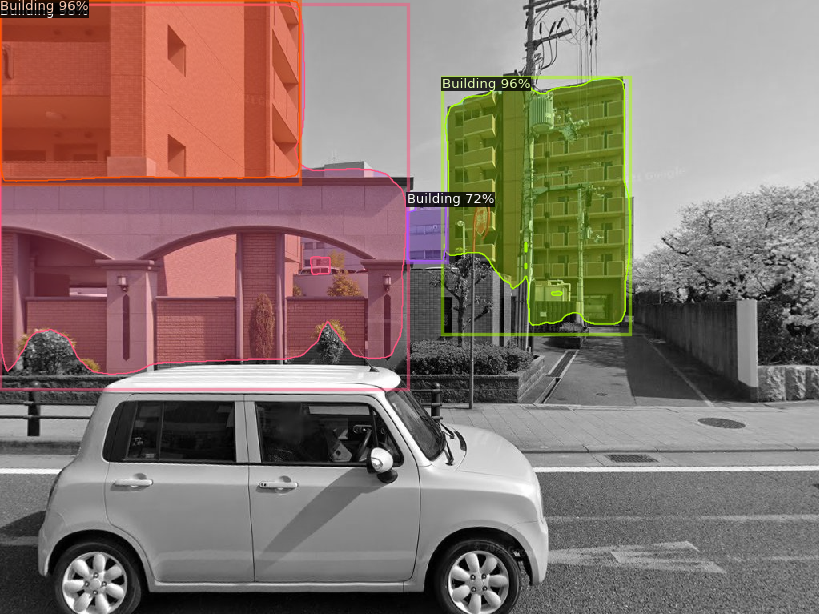

KeyboardInterrupt: 

In [ ]:
dataset_valid = DatasetCatalog.get(TEST_DATA_SET_NAME)

for d in dataset_valid:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)

    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=metadata,
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

